# Predicting crime rates with Facebook Prophet 

    I. Introduction 
    II. Data prep
    III. Predictions 
        A. Overall crime 
        B. Violent crime 
        C. Murder 
        D. 78701 
        E. 78753
        F. 78741
        G. 78745
    IV. Summary 

## I. Introduction 

## II. Data prep

In [1]:
# importing libraries and configurations 
import pandas as pd
import matplotlib.pyplot as plt
import warnings
from fbprophet import Prophet
from fbprophet.plot import plot_plotly

warnings.filterwarnings("ignore")
pd.set_option("display.max_columns", None)
%matplotlib inline
plt.style.use("seaborn")

In [2]:
# loading data
df = pd.read_csv(r"C:\Users\Robert\Crime Reports Analysis\df_clean.csv")

# reindexing the dataframe before breaking it into separate parts
df.occurred_date_time = df.occurred_date_time.astype("datetime64")
df.set_index(["occurred_date_time"], inplace=True)
df.sort_index(inplace=True)

In [3]:
# Creating separate dataframes for violent crime and murder
df_viol = df.query(
    'highest_offense_description == ["AGG ASSAULT", "AGG ROBBERY/DEADLY WEAPON", "CAPITAL MURDER", "MURDER", "RAPE"]'
)
df_viol_mur = df.query('highest_offense_description == ["MURDER", "CAPITAL MURDER"]')


# Creating zip code dataframes
df_01 = df[df.zip_code == 78701]
df_41 = df[df.zip_code == 78741]
df_45 = df[df.zip_code == 78745]
df_53 = df[df.zip_code == 78753]

## III. Predictions

### Overall crime 

INFO:fbprophet:Found custom seasonality named 'weekly', disabling built-in 'weekly' seasonality.
INFO:fbprophet:Found custom seasonality named 'daily', disabling built-in 'daily' seasonality.


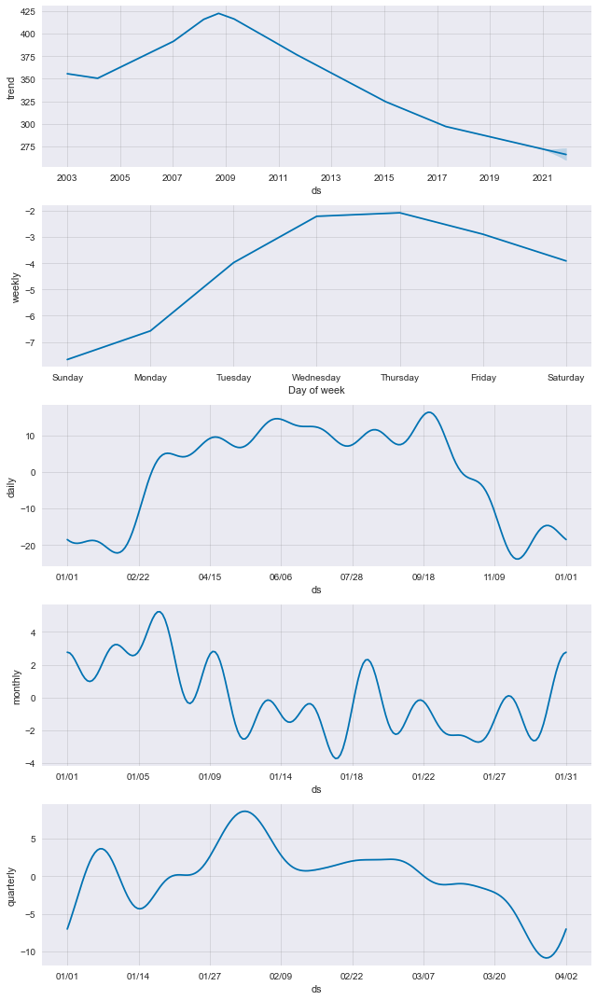

In [4]:
df_fbprophet = df
df_m_1 = df_fbprophet.resample("D").size().reset_index()
df_m_1.columns = ["date", "daily_crime_count"]
df_m_final_1 = df_m_1.rename(columns={"date": "ds", "daily_crime_count": "y"})

m_1 = Prophet(interval_width=0.95, yearly_seasonality=False)
m_1.add_seasonality(name="monthly", period=30.5, fourier_order=10)
m_1.add_seasonality(name="quarterly", period=91.5, fourier_order=10)
m_1.add_seasonality(name="weekly", period=52, fourier_order=10)
m_1.add_seasonality(name="daily", period=365, fourier_order=10)
m_1.fit(df_m_final_1)

future_1 = m_1.make_future_dataframe(periods=365, freq="D")
pred_1 = m_1.predict(future_1)

fig2_1 = m_1.plot_components(pred_1)
fig2_2 = plot_plotly(m_1, pred_1)
fig2_2

### Violent crime 

INFO:fbprophet:Found custom seasonality named 'weekly', disabling built-in 'weekly' seasonality.
INFO:fbprophet:Found custom seasonality named 'daily', disabling built-in 'daily' seasonality.


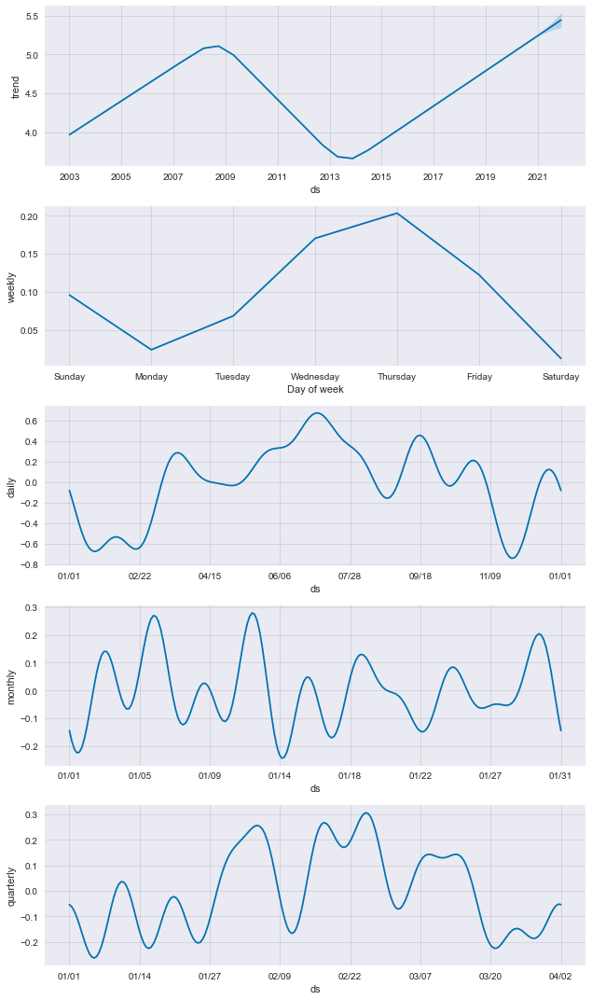

In [5]:
df_viol_fbprophet = df_viol
df_v = df_viol_fbprophet.resample("D").size().reset_index()
df_v.columns = ["date", "daily_crime_count"]
df_v_final = df_v.rename(columns={"date": "ds", "daily_crime_count": "y"})

v = Prophet(interval_width=0.95, yearly_seasonality=False)
v.add_seasonality(name="monthly", period=30.5, fourier_order=10)
v.add_seasonality(name="quarterly", period=91.5, fourier_order=10)
v.add_seasonality(name="weekly", period=52, fourier_order=10)
v.add_seasonality(name="daily", period=365, fourier_order=10)
v.fit(df_v_final)

future = v.make_future_dataframe(periods=365, freq="D")
pred = v.predict(future)

fig2_1 = v.plot_components(pred)
fig2_3 = plot_plotly(v, pred)
fig2_3

### Murder 

INFO:fbprophet:Found custom seasonality named 'weekly', disabling built-in 'weekly' seasonality.
INFO:fbprophet:Found custom seasonality named 'daily', disabling built-in 'daily' seasonality.


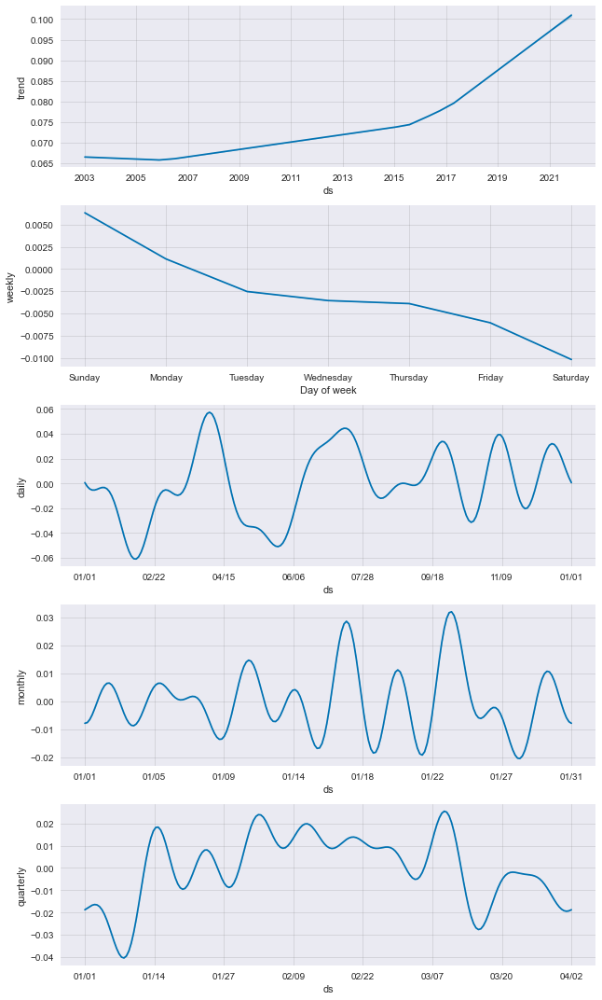

In [6]:
df_viol_mur_fbprophet = df_viol_mur
df_m = df_viol_mur_fbprophet.resample("D").size().reset_index()
df_m.columns = ["date", "daily_crime_count"]
df_m_final = df_m.rename(columns={"date": "ds", "daily_crime_count": "y"})
m = Prophet(interval_width=0.95, yearly_seasonality=False)
m.add_seasonality(name="monthly", period=30.5, fourier_order=10)
m.add_seasonality(name="quarterly", period=91.5, fourier_order=10)
m.add_seasonality(name="weekly", period=52, fourier_order=10)
m.add_seasonality(name="daily", period=365, fourier_order=10)
m.fit(df_m_final)
future = m.make_future_dataframe(periods=365, freq="D")
pred = m.predict(future)
fig3_1 = m.plot_components(pred)
fig3_3 = plot_plotly(m, pred)
fig3_3

### 78701 (downtown Austin)

In [7]:
df_fbprophet_01 = df_01
df_m_01 = df_fbprophet_01.resample("D").size().reset_index()
df_m_01.columns = ["date", "daily_crime_count"]
df_m_final_01 = df_m_01.rename(columns={"date": "ds", "daily_crime_count": "y"})

m_01 = Prophet(interval_width=0.95, yearly_seasonality=False)
m_01.add_seasonality(name="monthly", period=30.5, fourier_order=10)
m_01.add_seasonality(name="quarterly", period=91.5, fourier_order=10)
m_01.add_seasonality(name="weekly", period=52, fourier_order=10)
m_01.add_seasonality(name="daily", period=365, fourier_order=10)
m_01.fit(df_m_final_01)

future_01 = m_01.make_future_dataframe(periods=365, freq="D")
pred_01 = m_01.predict(future)

fig2_01_1 = plot_plotly(m_01, pred_01)
fig2_01_1

INFO:fbprophet:Found custom seasonality named 'weekly', disabling built-in 'weekly' seasonality.
INFO:fbprophet:Found custom seasonality named 'daily', disabling built-in 'daily' seasonality.


### 78753

INFO:fbprophet:Found custom seasonality named 'weekly', disabling built-in 'weekly' seasonality.
INFO:fbprophet:Found custom seasonality named 'daily', disabling built-in 'daily' seasonality.


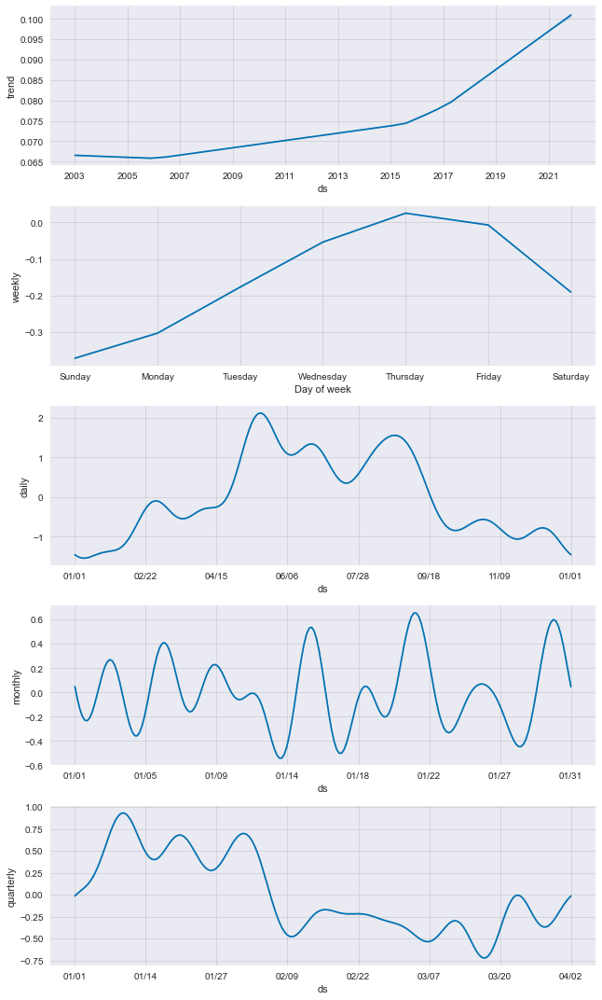

In [8]:
df_fbprophet_53 = df_53

df_m_53 = df_fbprophet_53.resample("D").size().reset_index()
df_m_53.columns = ["date", "weekly_crime_count"]
df_m_final_53 = df_m_53.rename(columns={"date": "ds", "weekly_crime_count": "y"})

m_53 = Prophet(interval_width=0.95, yearly_seasonality=False)
m_53.add_seasonality(name="monthly", period=30.5, fourier_order=10)
m_53.add_seasonality(name="quarterly", period=91.5, fourier_order=10)
m_53.add_seasonality(name="weekly", period=52, fourier_order=10)
m_53.add_seasonality(name="daily", period=365, fourier_order=10)
m_53.fit(df_m_final_53)

future_53 = m_53.make_future_dataframe(periods=365, freq="D")
pred_53 = m_53.predict(future)

fig2_53 = m_53.plot_components(pred)
fig2_53_1 = plot_plotly(m_53, pred_53)
fig2_53_1

### 78741 (highest crime concentration in Austin)

INFO:fbprophet:Found custom seasonality named 'weekly', disabling built-in 'weekly' seasonality.
INFO:fbprophet:Found custom seasonality named 'daily', disabling built-in 'daily' seasonality.


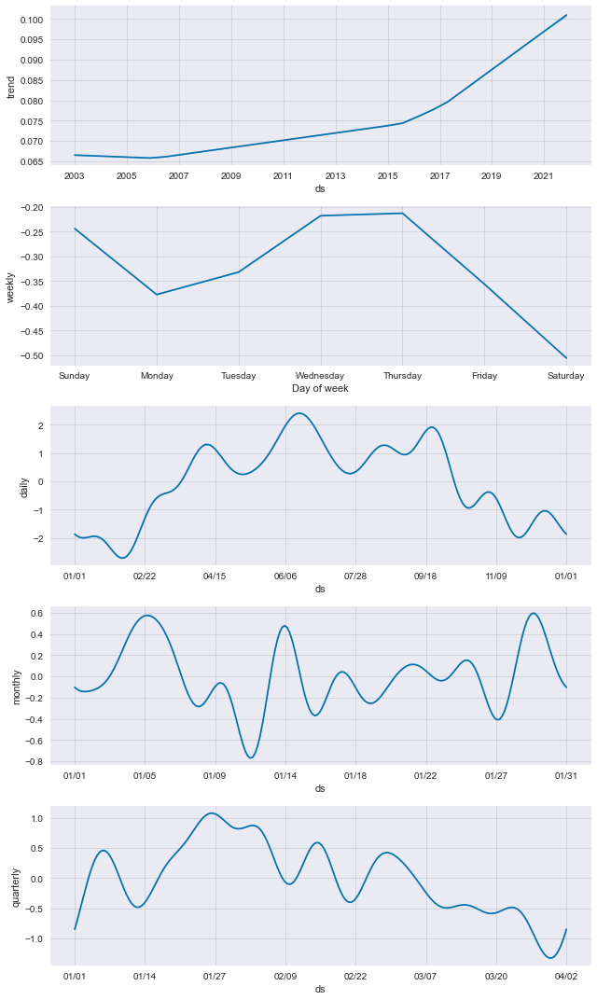

In [9]:
df_fbprophet_41 = df_41

df_m_41 = df_fbprophet_41.resample("D").size().reset_index()
df_m_41.columns = ["date", "weekly_crime_count"]
df_m_final_41 = df_m_41.rename(columns={"date": "ds", "weekly_crime_count": "y"})

m_41 = Prophet(interval_width=0.95, yearly_seasonality=False)
m_41.add_seasonality(name="monthly", period=30.5, fourier_order=10)
m_41.add_seasonality(name="quarterly", period=91.5, fourier_order=10)
m_41.add_seasonality(name="weekly", period=52, fourier_order=10)
m_41.add_seasonality(name="daily", period=365, fourier_order=10)
m_41.fit(df_m_final_41)

future_41 = m_41.make_future_dataframe(periods=365, freq="D")
pred_41 = m_41.predict(future)

fig2_41 = m_41.plot_components(pred)
fig2_41_1 = plot_plotly(m_41, pred_53)
fig2_41_1

### 78745 (far south Austin)

INFO:fbprophet:Found custom seasonality named 'weekly', disabling built-in 'weekly' seasonality.
INFO:fbprophet:Found custom seasonality named 'daily', disabling built-in 'daily' seasonality.


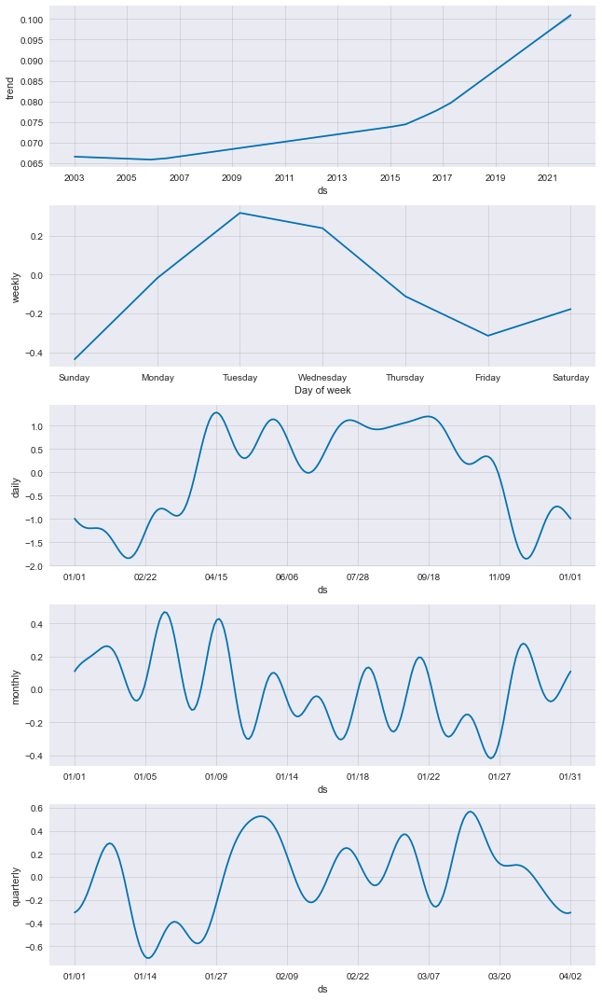

In [10]:
df_fbprophet_45 = df_45

df_m_45 = df_fbprophet_45.resample("D").size().reset_index()
df_m_45.columns = ["date", "daily_crime_count"]
df_m_final_45 = df_m_45.rename(columns={"date": "ds", "daily_crime_count": "y"})

m_45 = Prophet(interval_width=0.95, yearly_seasonality=False)
m_45.add_seasonality(name="monthly", period=30.5, fourier_order=10)
m_45.add_seasonality(name="quarterly", period=91.5, fourier_order=10)
m_45.add_seasonality(name="weekly", period=52, fourier_order=10)
m_45.add_seasonality(name="daily", period=365, fourier_order=10)
m_45.fit(df_m_final_45)

future_45 = m_45.make_future_dataframe(periods=365, freq="D")
pred_45 = m_45.predict(future)

fig2_45 = m_45.plot_components(pred)
fig2_45_1 = plot_plotly(m_45, pred_45)
fig2_45_1

## IV. Summary 

Overall crime reached its peak in January 2009, and began a steady decline. In 2019, it began a shallow upward trend. Projected crime rates, according to the model, can expect to remain steady for 2021 however.